In [1]:
import sys
import xarray as xr
import glob
import dask
import cartopy.crs as ccrs
import cmocean
import matplotlib.pyplot as plt
import re
import datetime
from functions.grid_to_km import area
import cartopy
import cartopy.crs as ccrs
import matplotlib as mpl
import numpy as np
from scipy.sparse import csr_matrix
import matplotlib.animation as animation
from matplotlib import rc

import IPython
from IPython.display import HTML



In [2]:
sys.path.insert(0,'.')    # '.' is in the same folder
%load_ext autoreload
%autoreload 1
#  Reload all modules imported with %aimport every time before executing the Python code typed.

%cd /home/students/6252699/thesis/parcels2/
%aimport advect_ice
%aimport plot_functions
%matplotlib inline



/home/students/6252699/thesis/parcels2


In [3]:
fig_dir = "/home/students/6252699/thesis/parcels2/figures/"
out_dir = "/scratch/AnnekeV/output/"

In [11]:
plt.style.use(['default'])


def set_axes():
    plt.figure(figsize = [8,8])
    ax = plt.axes(projection=ccrs.NorthPolarStereo())
    ax.gridlines(xlocs = np.arange(-180,185,20), ylocs = np.arange(-90, 95,5), color='black', alpha=0.5, linestyle=':')
    ax.add_feature(cartopy.feature.OCEAN)
    ax.add_feature(cartopy.feature.LAND)
    ax.set_extent([-180,180,50,90],  ccrs.PlateCarree())
    ax.coastlines()
    ax.stock_img()
    return ax

# Three kernels, 1000 days

In [101]:
kernel_sit   = "/scratch/AnnekeV/output/kernel_test_run_02_28_npart_11386_start_2014-02-01_simdays_1000_AdvectionRK4_ice.nc"
kernel_ocean = "/scratch/AnnekeV/output/kernel_test_run_02_28_npart_11386_start_2014-02-01_simdays_1000_AdvectionRK4_ocean.nc"
kernel_sic   = "/scratch/AnnekeV/output/kernel_test_run_02_28_npart_11386_start_2014-02-01_simdays_1000_AdvectionRK4_ice_sic.nc"
kernelnames = [kernel_sit, kernel_sic, kernel_ocean]

In [8]:
ds = xr.open_dataset(kernel_sit, decode_times=False)
ds

<xarray.Dataset>
Dimensions:     (obs: 201, traj: 11386)
Dimensions without coordinates: obs, traj
Data variables:
    trajectory  (traj, obs) int32 ...
    time        (traj, obs) float64 ...
    lat         (traj, obs) float32 ...
    lon         (traj, obs) float32 ...
    z           (traj, obs) float32 ...
    sic         (traj, obs) float32 ...
    sit         (traj, obs) float32 ...
Attributes:
    feature_type:           trajectory
    Conventions:            CF-1.6/CF-1.7
    ncei_template_version:  NCEI_NetCDF_Trajectory_Template_v2.0
    parcels_version:        2.0.0b0
    parcels_mesh:           spherical

In [99]:
plot_functions.plot_animation(kernel_sit, color_var="sic", save_gif=True, specific_savename = "kernel_sit")

Background is made
Animation is done
Done


In [100]:
plot_functions.plot_animation(kernel_sic, color_var="sic", save_gif = True, specific_savename = "kernel_sic")


Background is made
Animation is done
Done


In [11]:
plot_functions.plot_animation(kernel_sic, color_var="sic", save_gif = True, specific_savename = "kernel_ocean")

Background is made
Animation is done
Done


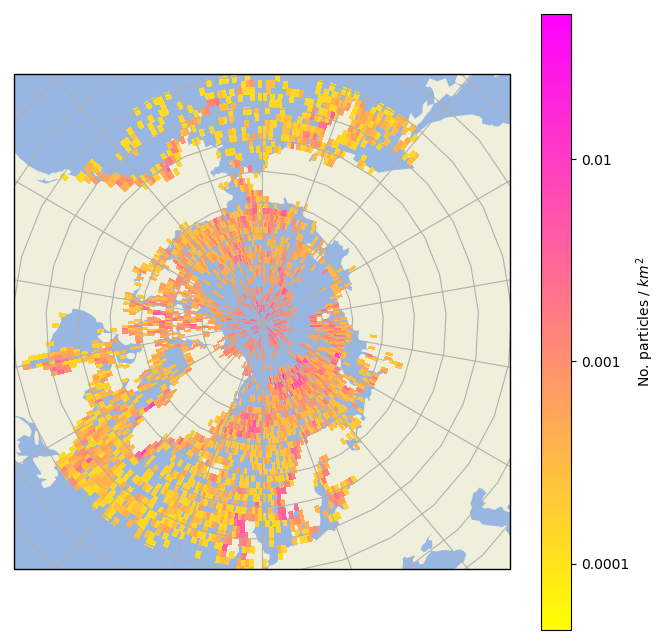

In [25]:

plot_functions.plot_histogram(kernel_sit, final=True, y_extent=50)#, specific_savename= "kernel_sit_final")

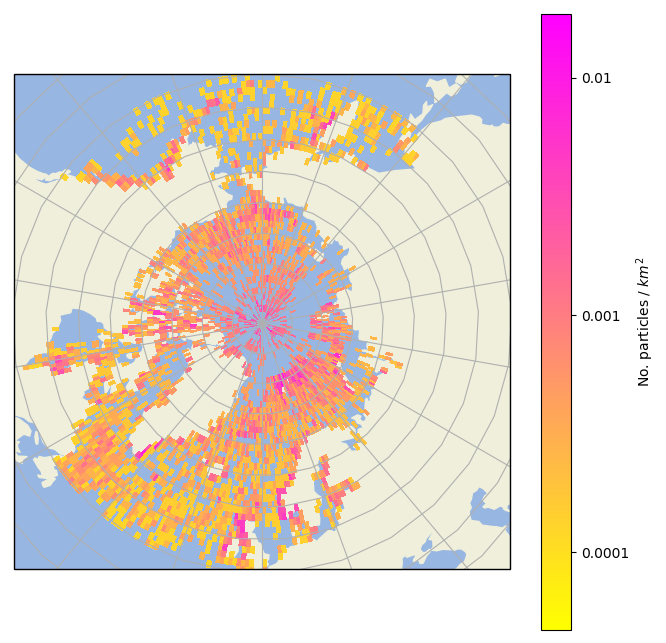

In [26]:
plot_functions.plot_histogram(kernel_sic, final=True, y_extent=50)#, specific_savename= "kernel_sit_final")

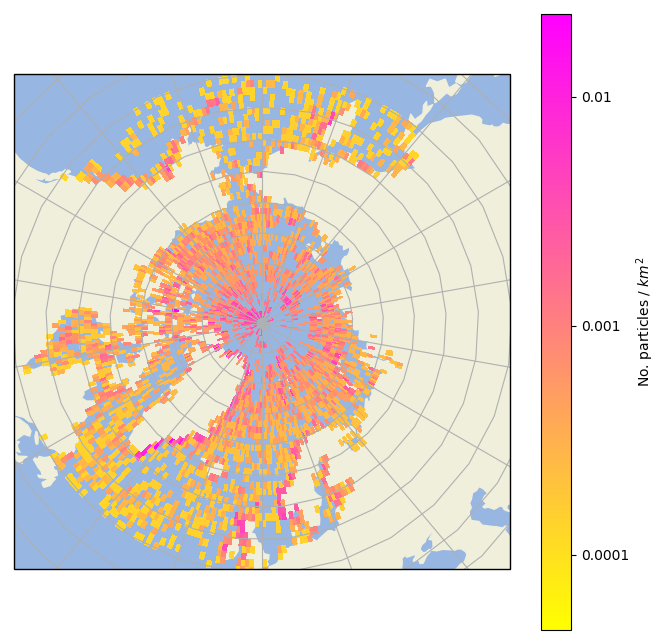

In [27]:
plot_functions.plot_histogram(kernel_ocean, final=True, y_extent=50)#, specific_savename= "kernel_sit_final")

In [29]:
ds_sic = xr.open_dataset(kernel_sic, decode_times=False)
ds_sit = xr.open_dataset(kernel_sit, decode_times=False)
ds_ocean = xr.open_dataset(kernel_ocean, decode_times=False)

In [53]:
ds_sic

<xarray.Dataset>
Dimensions:     (obs: 201, traj: 11386)
Dimensions without coordinates: obs, traj
Data variables:
    trajectory  (traj, obs) int32 ...
    time        (traj, obs) float64 ...
    lat         (traj, obs) float32 ...
    lon         (traj, obs) float32 ...
    z           (traj, obs) float32 ...
    sic         (traj, obs) float32 nan 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    sit         (traj, obs) float32 ...
Attributes:
    feature_type:           trajectory
    Conventions:            CF-1.6/CF-1.7
    ncei_template_version:  NCEI_NetCDF_Trajectory_Template_v2.0
    parcels_version:        2.0.0b0
    parcels_mesh:           spherical

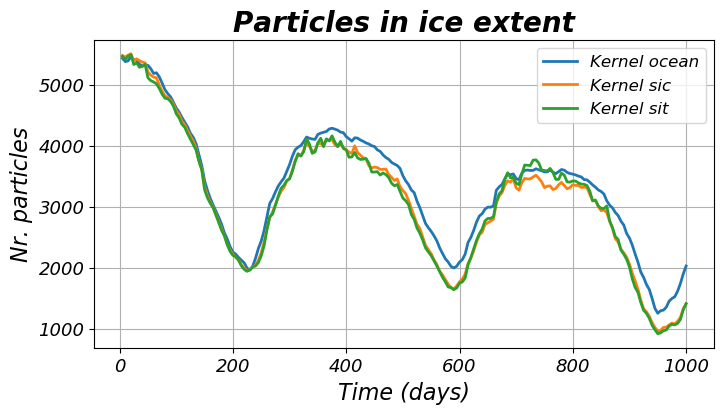

In [98]:
sic_ext = ds_sic.sic.where(ds_sic.sic>0.15).count(axis=0).values[1:]
sit_ext = ds_sit.sic.where(ds_sit.sic>0.15).count(axis=0).values[1:]
oce_ext = ds_sit.sic.where(ds_ocean.sic>0.15).count(axis=0).values[1:]

plt.figure()
plt.title("Particles in ice extent")
plt.xlabel("Time (days)")
plt.ylabel("Nr. particles")

time = np.arange(1,len(sic_ext)+1)*5

plt.plot(time, oce_ext, label = "Kernel ocean")
plt.plot(time, sic_ext, label = "Kernel sic")
plt.plot(time, sit_ext, label = "Kernel sit")

plt.legend()


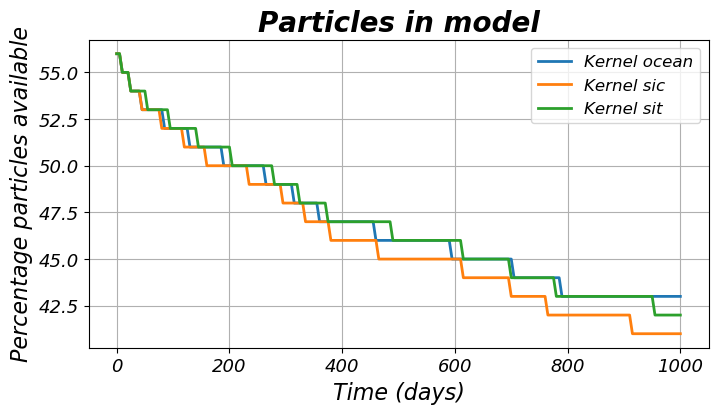

In [91]:
sic_notnan = ds_sic.lat.count(axis=0).values / len(sic_notnan)
sit_notnan = ds_sit.lat.count(axis=0).values / len(sic_notnan)
oce_notnan = ds_ocean.lat.count(axis=0).values / len(sic_notnan)


plt.figure()
plt.title("Particles in model")
plt.xlabel("Time (days)")
plt.ylabel("Percentage particles available")

time = np.arange(len(sic_ext))*5

plt.plot(time, oce_notnan, label = "Kernel ocean")
plt.plot(time, sic_notnan, label = "Kernel sic")
plt.plot(time, sit_notnan, label = "Kernel sit")

plt.legend()

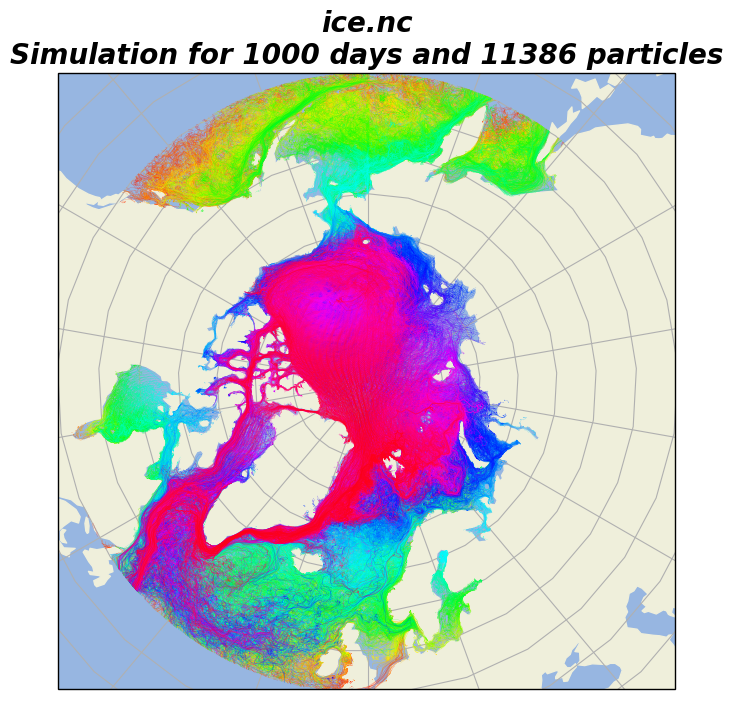

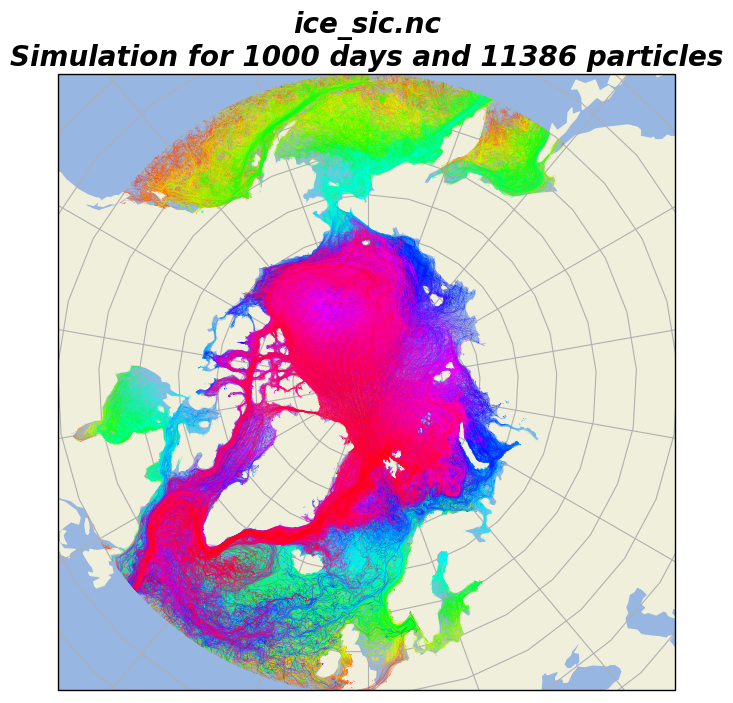

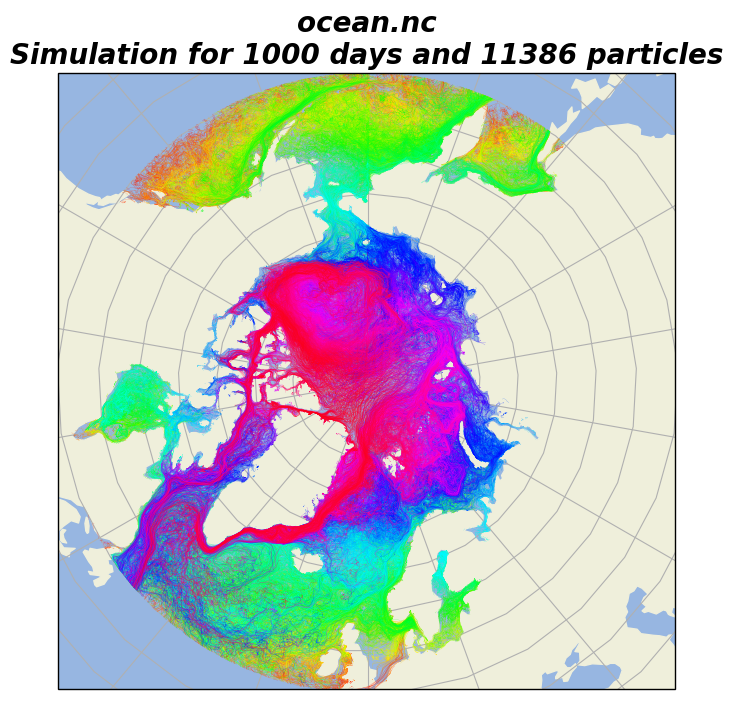

In [104]:
for k in kernelnames:
    typ = k.split("RK4_")[1]
    plot_functions.plot_trajectory_map(k, extra_title=typ, y_extent=50)

In [5]:
ds = xr.open_dataset('/home/students/6252699/thesis/parcels2/output/test2_ice_or_ocean_kernel_npart_11386_start_2014-02-01_simdays_35_AdvectionRK4_ice_sic.nc', decode_times = False)

In [6]:
ds

<xarray.Dataset>
Dimensions:     (obs: 8, traj: 11386)
Dimensions without coordinates: obs, traj
Data variables:
    trajectory  (traj, obs) int32 ...
    time        (traj, obs) float64 ...
    lat         (traj, obs) float32 ...
    lon         (traj, obs) float32 ...
    z           (traj, obs) float32 ...
    sic         (traj, obs) float32 ...
    in_ice      (traj, obs) float32 ...
    sit         (traj, obs) float32 ...
Attributes:
    feature_type:           trajectory
    Conventions:            CF-1.6/CF-1.7
    ncei_template_version:  NCEI_NetCDF_Trajectory_Template_v2.0
    parcels_version:        2.0.0b0
    parcels_mesh:           spherical

In [7]:
ds.in_ice

<xarray.DataArray 'in_ice' (traj: 11386, obs: 8)>
array([[nan,  0.,  0., ...,  0.,  0.,  0.],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan,  1.,  1., ...,  1.,  1.,  1.],
       [nan,  1.,  1., ...,  1.,  1.,  1.],
       [nan,  1.,  1., ...,  1.,  1.,  1.]], dtype=float32)
Dimensions without coordinates: traj, obs
Attributes:
    long_name:      
    standard_name:  in_ice
    units:          unknown

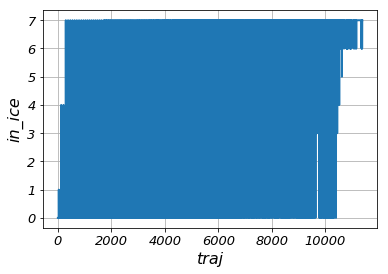

In [9]:
ds.in_ice.sum(dim= "obs").plot()

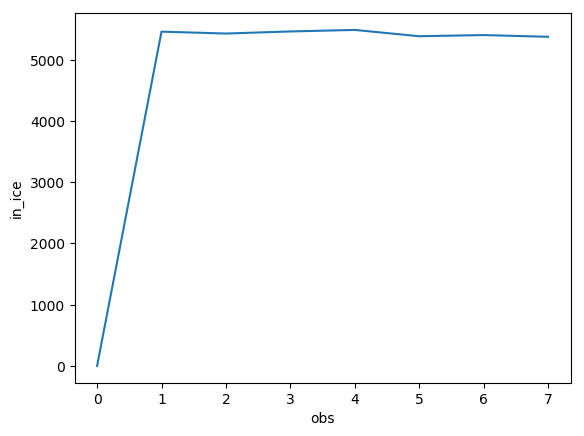

In [12]:
ds.in_ice.sum(dim="traj").plot()